In [1]:
import os
import sys
import random
import warnings

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm import tqdm_notebook, tnrange
from skimage.io import imread, imshow, concatenate_images
from skimage.transform import resize
from skimage.morphology import label
from sklearn.model_selection import train_test_split
from keras.preprocessing.image import array_to_img, img_to_array, load_img
from skimage.feature import canny
from skimage.filters import sobel,threshold_otsu, threshold_niblack,threshold_sauvola
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from scipy import signal

import cv2
from PIL import Image
import pdb
from tqdm import tqdm
import seaborn as sns
import os 
from glob import glob

import warnings
warnings.filterwarnings("ignore")

Using TensorFlow backend.


In [2]:
INPUT_PATH = '../input'
DATA_PATH = INPUT_PATH
TRAIN_DATA = os.path.join(DATA_PATH, "images/images/")
GT = os.path.join(DATA_PATH, "gt/gt/")

In [3]:
def get_image_data(image_id, image_type, **kwargs):
    img = _get_image_data_opencv(image_id, image_type, **kwargs)
    img = img.astype('uint8')
    return img

def _get_image_data_opencv(image_id, image_type, **kwargs):
    fname = get_filename(image_id, image_type)
    img = cv2.imread(fname)
    assert img is not None, "Failed to read image : %s, %s" % (image_id, image_type)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

# https://github.com/ternaus/TernausNet/blob/master/Example.ipynb
def mask_overlay(image, mask):
    """
    Helper function to visualize mask
    """
    mask = mask.astype(np.uint8)
    weighted_sum = cv2.addWeighted(mask, 0.75, image, 0.5, 0.)
    img = image.copy()
    ind = mask[:, :, 1] > 0    
    img[ind] = weighted_sum[ind]    
    return img

In [4]:
print("TRAIN DATA: ", len([name for name in os.listdir(TRAIN_DATA) if os.path.isfile(os.path.join(TRAIN_DATA, name))]))
print("GROUND TRUTH: ", len([name for name in os.listdir(GT) if os.path.isfile(os.path.join(GT, name))]))

TRAIN DATA:  180
GROUND TRUTH:  180


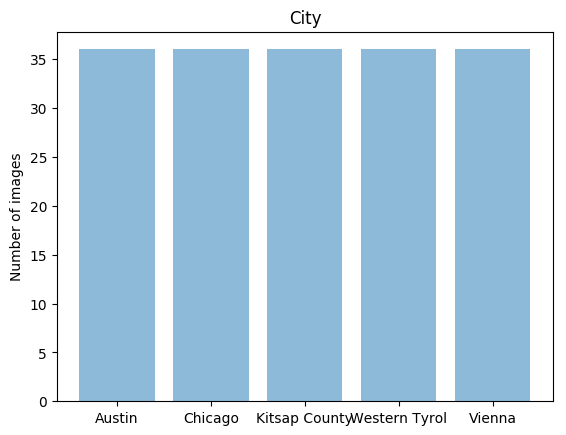

In [5]:
nai = len([name for name in os.listdir(TRAIN_DATA) if (os.path.isfile(os.path.join(TRAIN_DATA, name)) and name.find("austin") >= 0)])
nci = len([name for name in os.listdir(TRAIN_DATA) if (os.path.isfile(os.path.join(TRAIN_DATA, name)) and name.find("chicago") >= 0)])
nki = len([name for name in os.listdir(TRAIN_DATA) if (os.path.isfile(os.path.join(TRAIN_DATA, name)) and name.find("kitsap") >= 0)])
nwi = len([name for name in os.listdir(TRAIN_DATA) if (os.path.isfile(os.path.join(TRAIN_DATA, name)) and name.find("tyrol") >= 0)])
nvi = len([name for name in os.listdir(TRAIN_DATA) if (os.path.isfile(os.path.join(TRAIN_DATA, name)) and name.find("vienna") >= 0)])
import matplotlib.pyplot as plt; plt.rcdefaults()
import numpy as np
import matplotlib.pyplot as plt
 
objects = ('Austin', 'Chicago', 'Kitsap County', 'Western Tyrol', 'Vienna')
y_pos = np.arange(len(objects))
number_images = [nai, nci, nki, nwi, nvi]
 
plt.bar(y_pos, number_images, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.ylabel('Number of images')
plt.title('City')
 
plt.show()

In [6]:
from keras.preprocessing.image import load_img
path, dirs, imgs = next(os.walk("../input/images/images/"))
from keras.preprocessing.image import load_img
print("Fist image: %s" % imgs[0])
image = load_img(TRAIN_DATA + imgs[0])
image

Fist image: tyrol-w5.tif


Fist image: tyrol-w5.tif


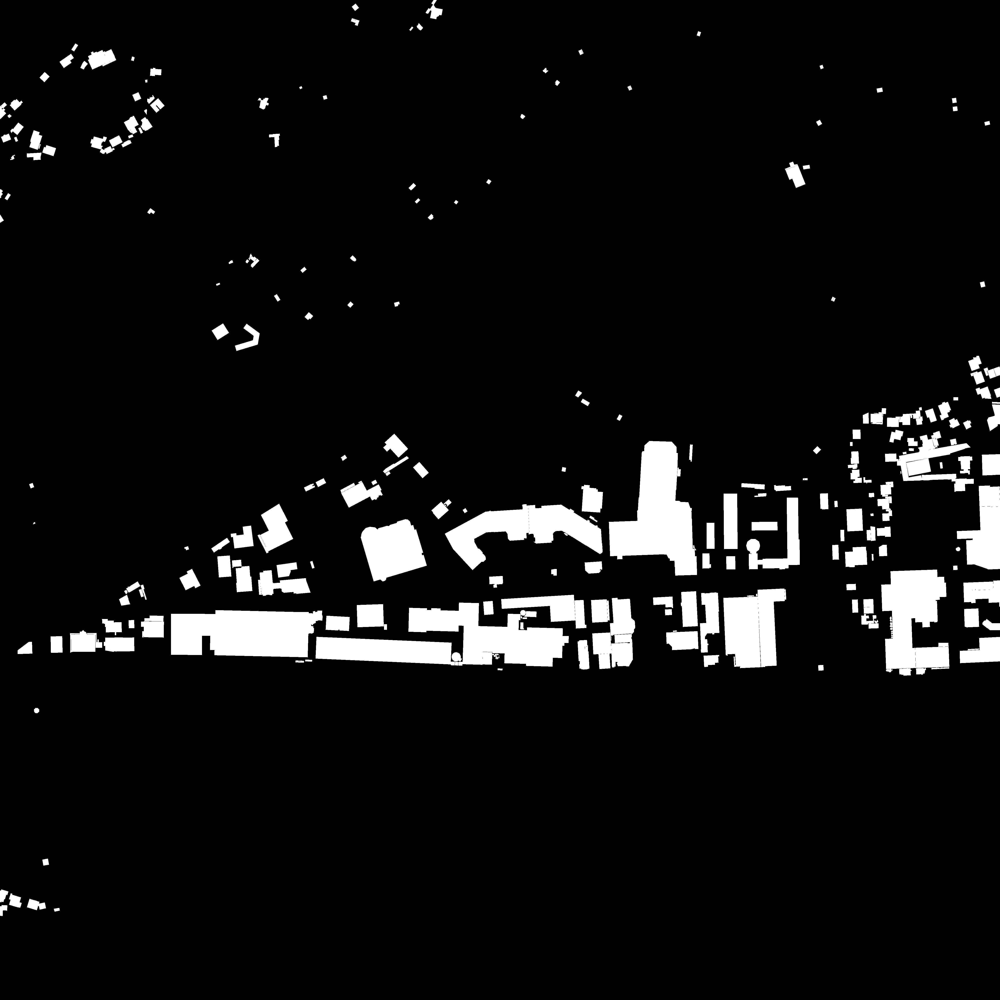

In [7]:
path_gt, dirs_gt, gts = next(os.walk("../input/images/images/"))
print("Fist image: %s" % gts[0])
gt = load_img(GT + gts[0])
gt

In [8]:
from keras.preprocessing.image import img_to_array
image = img_to_array(image)
image.shape

(5000, 5000, 3)